**Objective of the project
The goal of this machine learning project is to predict whether a person makes over 50K a year or not given their demographic variation. To achieve this, several classification techniques are explored and the random forest model yields to the best prediction resut*


In [1]:
import numpy as np
import pandas as pd
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
import plotly.express as px
import cufflinks as cf
import seaborn as sns
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline
final=[]

**load the dataset**

In [2]:
df=pd.read_csv("adult.csv")

In [3]:
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,?,103497,Some-college,10,Never-married,?,Own-child,White,Female,0,0,30,United-States,<=50K


In [4]:
df.describe()

,age,fnlwgt,educational-num,capital-gain,capital-loss,hours-per-week
count,48842.000000,4.884200e+04,48842.000000,48842.000000,48842.000000,48842.000000
mean,38.643585,1.896641e+05,10.078089,1079.067626,87.502314,40.422382
std,13.710510,1.056040e+05,2.570973,7452.019058,403.004552,12.391444
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.175505e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.781445e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.376420e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.490400e+06,16.000000,99999.000000,4356.000000,99.000000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48842 entries, 0 to 48841
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   age              48842 non-null  int64 
 1   workclass        48842 non-null  object
 2   fnlwgt           48842 non-null  int64 
 3   education        48842 non-null  object
 4   educational-num  48842 non-null  int64 
 5   marital-status   48842 non-null  object
 6   occupation       48842 non-null  object
 7   relationship     48842 non-null  object
 8   race             48842 non-null  object
 9   gender           48842 non-null  object
 10  capital-gain     48842 non-null  int64 
 11  capital-loss     48842 non-null  int64 
 12  hours-per-week   48842 non-null  int64 
 13  native-country   48842 non-null  object
 14  income           48842 non-null  object
dtypes: int64(6), object(9)
memory usage: 5.6+ MB


# visulaization

In [6]:
#work class
df['workclass'].value_counts()

workclass
Private             33906
Self-emp-not-inc     3862
Local-gov            3136
?                    2799
State-gov            1981
Self-emp-inc         1695
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: count, dtype: int64

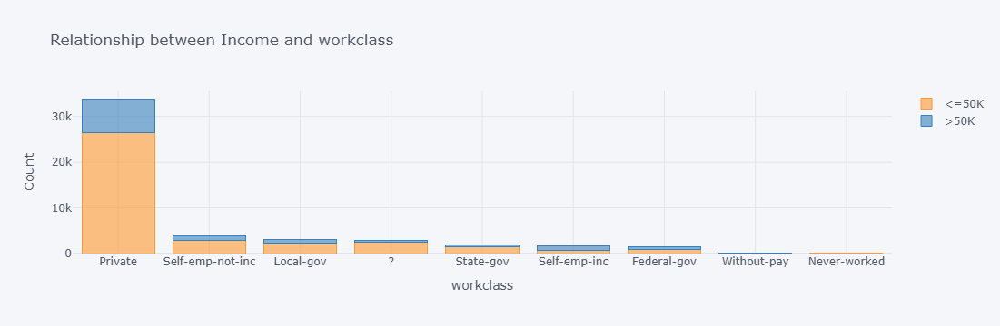

In [7]:
#counts
workclass_income_counts = df.groupby(['workclass', 'income']).size().unstack()
workclass_income_counts = workclass_income_counts.loc[
    workclass_income_counts.sum(axis=1).sort_values(ascending=False).index
]

# Plot using iplot
workclass_income_counts.iplot(
    kind='bar',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between Income and workclass',
    xTitle='workclass',
    yTitle='Count',
)


In [8]:
df['education'].value_counts()

education
HS-grad         15784
Some-college    10878
Bachelors        8025
Masters          2657
Assoc-voc        2061
11th             1812
Assoc-acdm       1601
10th             1389
7th-8th           955
Prof-school       834
9th               756
12th              657
Doctorate         594
5th-6th           509
1st-4th           247
Preschool          83
Name: count, dtype: int64

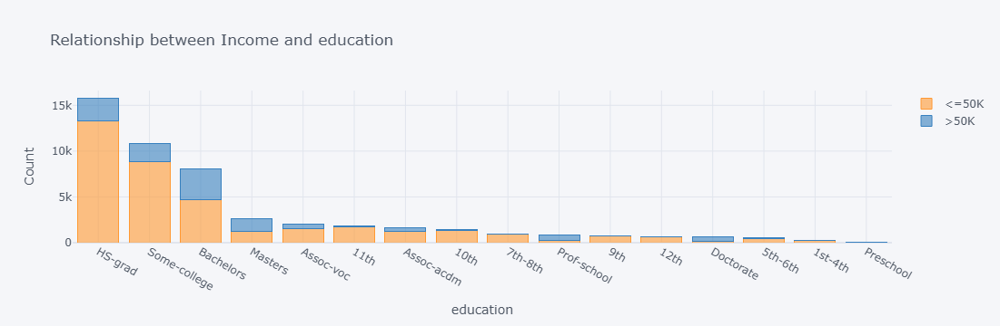

In [9]:
#counts
education_income_counts = df.groupby(['education', 'income']).size().unstack()
education_income_counts = education_income_counts.loc[
    education_income_counts.sum(axis=1).sort_values(ascending=False).index
]

# Plot using iplot
education_income_counts.iplot(
    kind='bar',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between Income and education',
    xTitle='education',
    yTitle='Count',
)

In [10]:
df['marital-status'].value_counts()

marital-status
Married-civ-spouse       22379
Never-married            16117
Divorced                  6633
Separated                 1530
Widowed                   1518
Married-spouse-absent      628
Married-AF-spouse           37
Name: count, dtype: int64

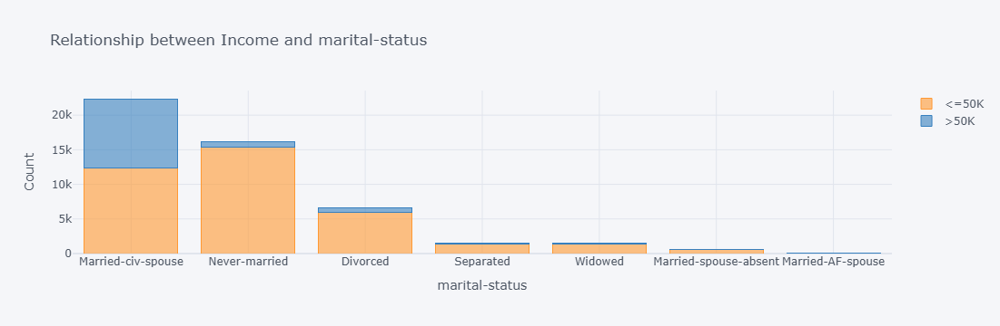

In [11]:
#counts
marital_status_counts = df.groupby(['marital-status', 'income']).size().unstack()
marital_status_counts = marital_status_counts.loc[
    marital_status_counts.sum(axis=1).sort_values(ascending=False).index
]

# Plot using iplot
marital_status_counts.iplot(
    kind='bar',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between Income and marital-status',
    xTitle='marital-status',
    yTitle='Count',
)

In [12]:
df['occupation'].value_counts()

occupation
Prof-specialty       6172
Craft-repair         6112
Exec-managerial      6086
Adm-clerical         5611
Sales                5504
Other-service        4923
Machine-op-inspct    3022
?                    2809
Transport-moving     2355
Handlers-cleaners    2072
Farming-fishing      1490
Tech-support         1446
Protective-serv       983
Priv-house-serv       242
Armed-Forces           15
Name: count, dtype: int64

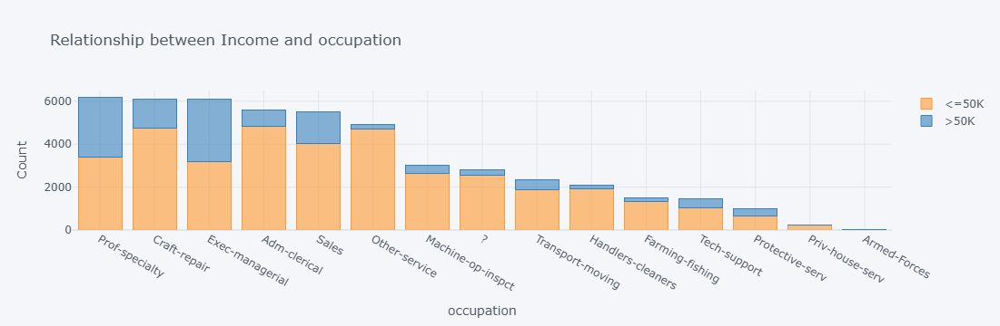

In [13]:
#counts
occupation_income_counts = df.groupby(['occupation', 'income']).size().unstack()
occupation_income_counts = occupation_income_counts.loc[
    occupation_income_counts.sum(axis=1).sort_values(ascending=False).index
]

# Plot using iplot
occupation_income_counts.iplot(
    kind='bar',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between Income and occupation',
    xTitle='occupation',
    yTitle='Count',
)

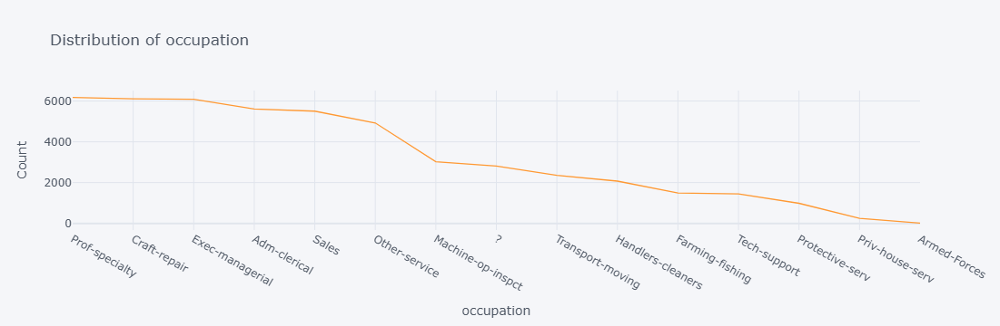

In [14]:
#occupation
work_class_counts = df['occupation'].value_counts()
work_class_counts.iplot(kind='scatter',title='Distribution of occupation',xTitle='occupation',yTitle='Count')

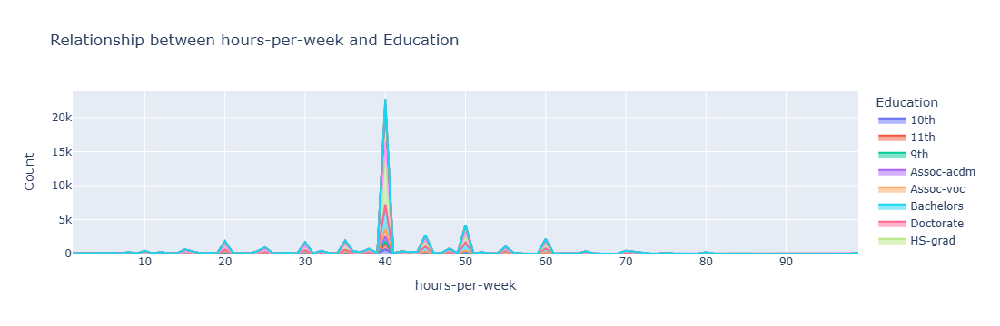

In [15]:
hours_per_week_education = df.groupby(['hours-per-week', 'education']).size().reset_index(name='count')

# Create a grouped bar chart
fig = px.area(
    hours_per_week_education,
    x='hours-per-week',
    y='count',
    color='education',
    #barmode='group',
    labels={'count': 'Count', 'hours-per-week': 'hours-per-week', 'education': 'Education'},
    title='Relationship between hours-per-week and Education'
)

fig.show()

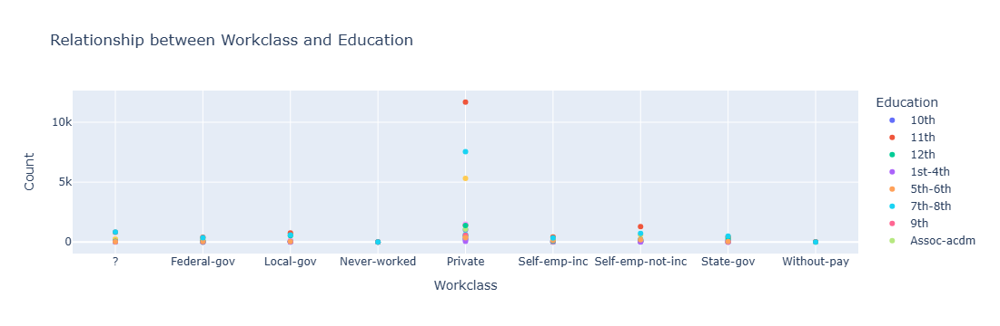

In [16]:
workclass_education = df.groupby(['workclass', 'education']).size().reset_index(name='count')

# Create a grouped bar chart
fig = px.scatter(
    workclass_education,
    x='workclass',
    y='count',
    color='education',
    #barmode='group',
    labels={'count': 'Count', 'workclass': 'Workclass', 'education': 'Education'},
    title='Relationship between Workclass and Education'
)

fig.show()

In [17]:
#relationship
df['relationship'].value_counts()

relationship
Husband           19716
Not-in-family     12583
Own-child          7581
Unmarried          5125
Wife               2331
Other-relative     1506
Name: count, dtype: int64

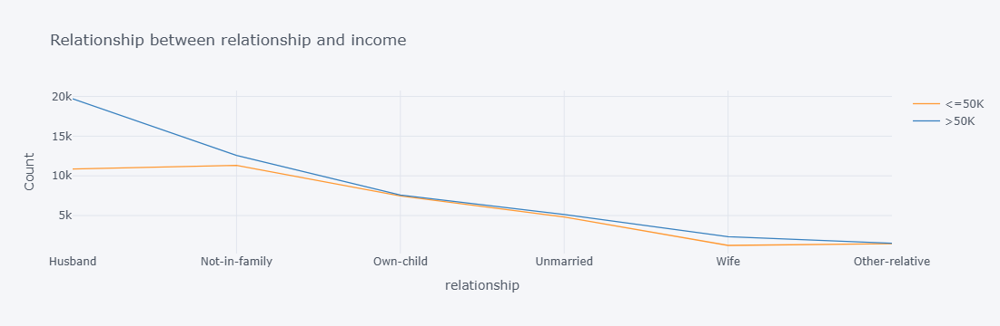

In [18]:
#counts
relationship_income_counts = df.groupby(['relationship', 'income']).size().unstack()
relationship_income_counts = relationship_income_counts.loc[
    relationship_income_counts.sum(axis=1).sort_values(ascending=False).index
]

# Plot using iplot
relationship_income_counts.iplot(
    kind='area',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between relationship and income',
    xTitle='relationship',
    yTitle='Count',
  
)


In [19]:
#race
df['race'].value_counts()

race
White                 41762
Black                  4685
Asian-Pac-Islander     1519
Amer-Indian-Eskimo      470
Other                   406
Name: count, dtype: int64

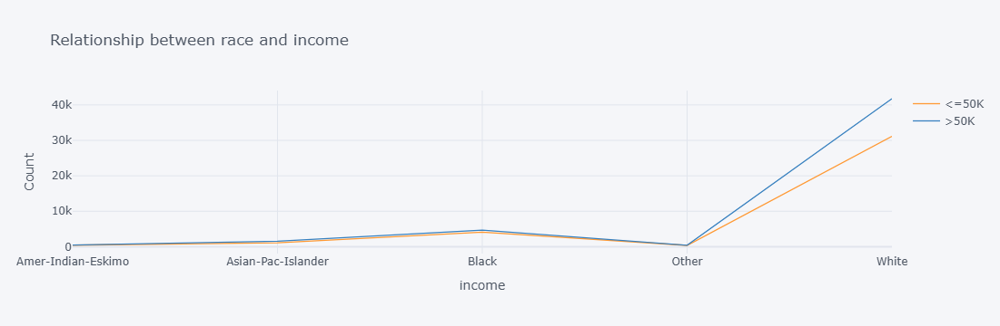

In [20]:
#counts
race_income_counts = df.groupby(['race', 'income']).size().unstack()

# Plot using iplot
race_income_counts.iplot(
    kind='area',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between race and income',
    xTitle='income',
    yTitle='Count',
    theme='pearl'  # Optional: Change theme
)


In [21]:
#gender
df['gender'].value_counts()

gender
Male      32650
Female    16192
Name: count, dtype: int64

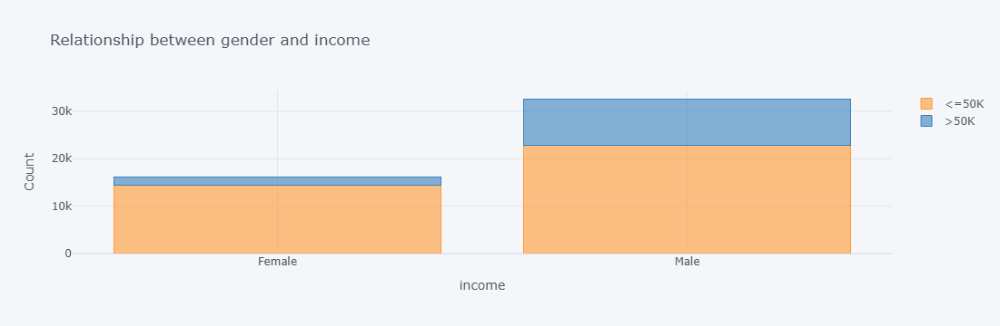

In [22]:
#counts
gender_income_counts = df.groupby(['gender', 'income']).size().unstack()

# Plot using iplot
gender_income_counts.iplot(
    kind='bar',
    barmode='stack',  # Stack bars for income categories
    title='Relationship between gender and income',
    xTitle='income',
    yTitle='Count',
    
)


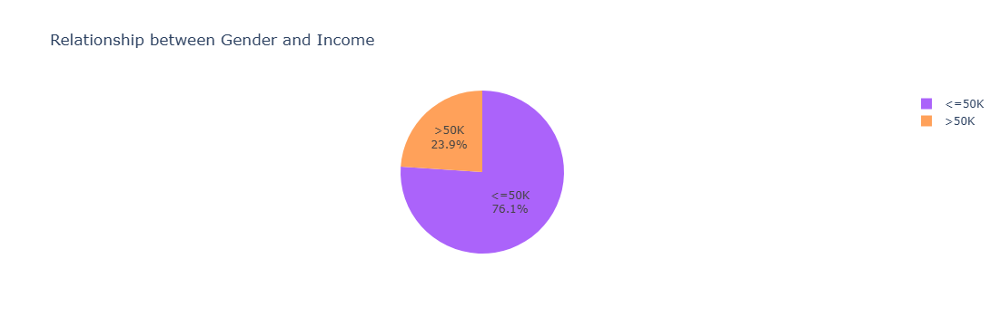

In [23]:
gender_income_counts = df.groupby(['gender', 'income']).size().reset_index(name='count')
income_colors = {
    'Low': 'blue',  
    'Medium': 'green',  
    'High': 'red',  
}

# Plot a pie chart with custom colors for income
fig = px.pie(
    gender_income_counts, 
    names='income',  # Use 'income' for pie segments
    values='count',  # Use 'count' for the size of each pie slice
    color='income',  # Color the segments based on income (not gender)
    color_discrete_map=income_colors,  # Use the custom colors for income
    title='Relationship between Gender and Income',
    labels={'income': 'Income', 'count': 'Count'},
)

fig.update_traces(textinfo='percent+label')  # Display percentage and labels on the pie chart

fig.show()


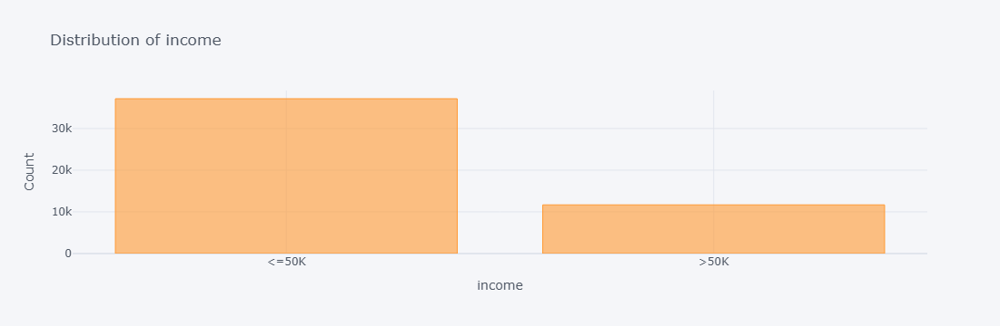

In [24]:
#income
income_counts = df['income'].value_counts()
income_counts.iplot(kind='bar',title='Distribution of income',xTitle='income',yTitle='Count',theme='pearl'
)

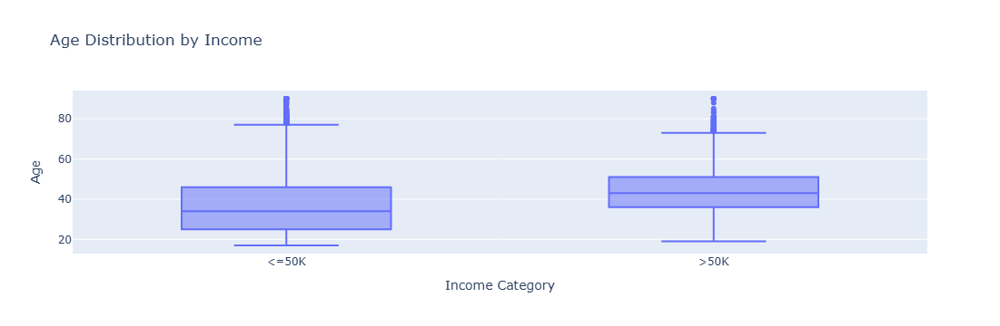

In [25]:
import plotly.express as px

# Create a boxplot
fig = px.box(
    df,
    x='income',  # Income category on the x-axis
    y='age',  # Age distribution on the y-axis
    title='Age Distribution by Income',
    labels={'income': 'Income Category', 'age': 'Age'}
)
fig.show()


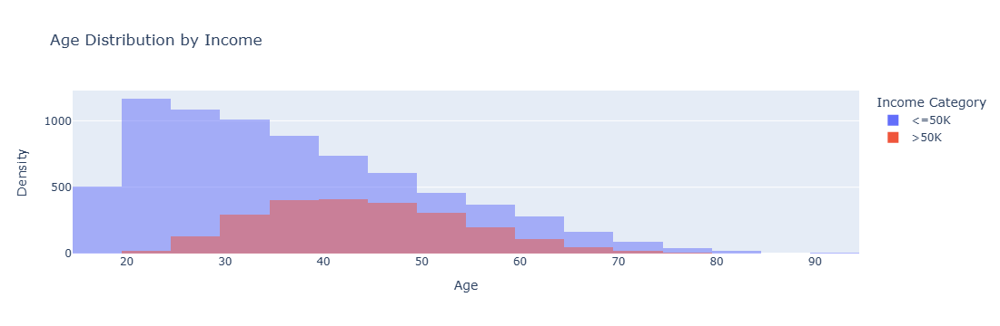

In [26]:
import plotly.express as px

# KDE-like plot using Plotly
fig = px.histogram(
    df,
    x="age",
    color="income",
    histnorm="density",  # Normalize histogram to represent density
    barmode="overlay",   # Overlay the distributions
    nbins=30,            # Number of bins for smoother appearance
    opacity=0.5,         # Transparency for overlapping
    title="Age Distribution by Income"
)

# Customize axes
fig.update_layout(
    xaxis_title="Age",
    yaxis_title="Density",
    legend_title="Income Category"
)

fig.show()


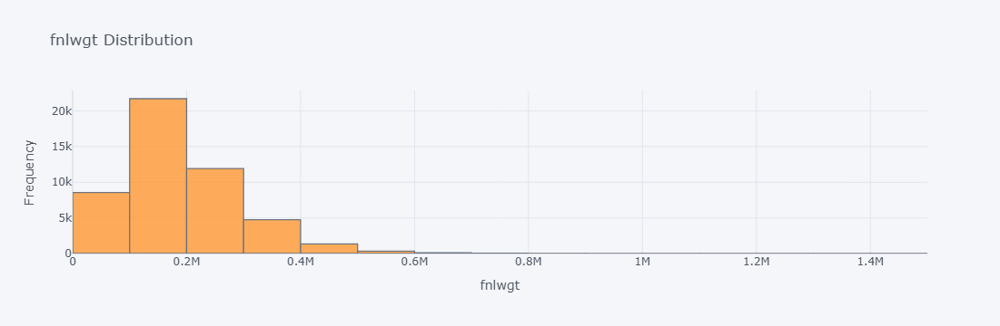

In [27]:
#fnlwgte
df['fnlwgt'].iplot(
    kind='hist',
    bins=20,  # Number of bins
    title='fnlwgt Distribution',
    xTitle='fnlwgt',
    yTitle='Frequency',
  
)

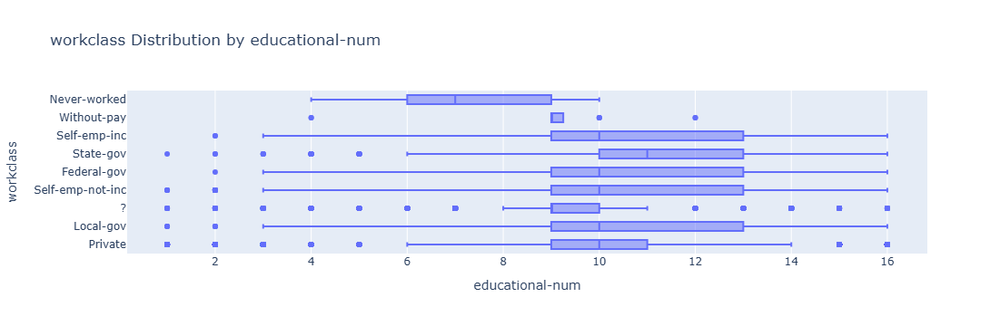

In [28]:
import plotly.express as px

# Create a boxplot
fig = px.box(
    df,
    x='educational-num',  # educational-num  on the x-axis
    y='workclass',  # workclass distribution on the y-axis
    title='workclass Distribution by educational-num',
    labels={'educational-num': 'educational-num', 'workclass': 'workclass'}
)
fig.show()


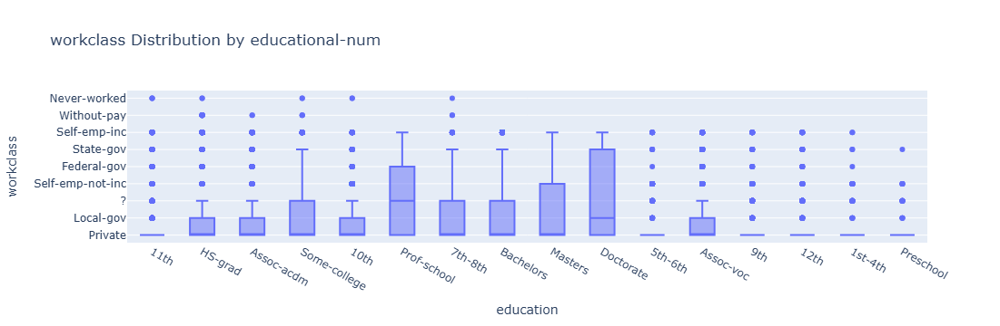

In [29]:
import plotly.express as px

# Create a boxplot
fig = px.box(
    df,
    x='education',  # educational-num  on the x-axis
    y='workclass',  # workclass distribution on the y-axis
    title='workclass Distribution by educational-num',
    labels={'educational-num': 'educational-num', 'workclass': 'workclass'}
)
fig.show()


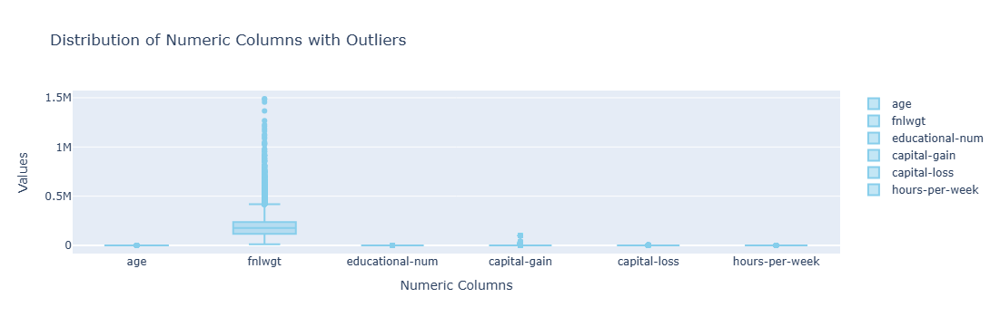

In [30]:
# Initialize a figure
fig = go.Figure()

# Iterate over numeric columns in the DataFrame
for column in df.select_dtypes(include=['number']).columns:
    fig.add_trace(go.Box(
        y=df[column],
        name=column,
        marker=dict(color='skyblue')
    ))

# Update layout with a title and axis labels
fig.update_layout(
    title='Distribution of Numeric Columns with Outliers',
    yaxis_title='Values',
    xaxis_title='Numeric Columns'
)

# Show the figure
fig.show()


befor scaling

befor normalization

# cleaning data

In [31]:
#Handle missing values
columns_with_question_marks = []
for column in df.columns:
    if df[column].isin(['?']).any():
        columns_with_question_marks.append(column)

print("Columns with question marks:", columns_with_question_marks)


df[columns_with_question_marks] = df[columns_with_question_marks].replace('?', np.nan)
missing_values = df.isnull().sum()  
print('the number missing in data: ',missing_values)

df.head()



Columns with question marks: ['workclass', 'occupation', 'native-country']
the number missing in data:  age                   0
workclass          2799
fnlwgt                0
education             0
educational-num       0
marital-status        0
occupation         2809
relationship          0
race                  0
gender                0
capital-gain          0
capital-loss          0
hours-per-week        0
native-country      857
income                0
dtype: int64


,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,25,Private,226802,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,89814,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,336951,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,160323,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,18,NaN,103497,Some-college,10,Never-married,NaN,Own-child,White,Female,0,0,30,United-States,<=50K


In [32]:
#duplicate
print('shape of data befor drop duplicate' ,df.shape)
duplicates=df[df.duplicated()]
df=df.drop_duplicates()
print('shape of data after drop duplicate' ,df.shape)

shape of data befor drop duplicate (48842, 15)
shape of data after drop duplicate (48790, 15)


In [33]:
#Handaling outlier
def outliers_handler(real_data:pd.DataFrame(),col_name:str)->pd.DataFrame():
    data=real_data.copy()
    q1 = np.percentile(data[col_name],25)
    q3 = np.percentile(data[col_name],75)
    iqr = q3-q1
    upper_bound = q3+(1.5*iqr)
    lower_bound = q1-(1.5*iqr)
    outliers = (data[col_name]>upper_bound) | (data[col_name]<lower_bound)
    num_of_outliers = len(data[outliers])
    if num_of_outliers <= len(data)*0.1:
        data = data[~outliers]
        print("Outliers dropped")
    else:
        data.loc[data[col_name]>upper_bound,col_name] = upper_bound
        data.loc[data[col_name]<lower_bound,col_name] = lower_bound
        print("Outliers replaced")
    return data
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
for i in numeric_cols:
    df=outliers_handler(df,i)

Outliers dropped
Outliers dropped
Outliers dropped
Outliers dropped
Outliers dropped
Outliers replaced


C:\Users\Amera\AppData\Local\Temp\ipykernel_1408\2368871999.py:15: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '52.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.



In [34]:
# Apply log transformation (log1p handles zero values)
df['age'] = np.log1p(df['age'])
df['educational-num'] = np.log1p(df['educational-num'])

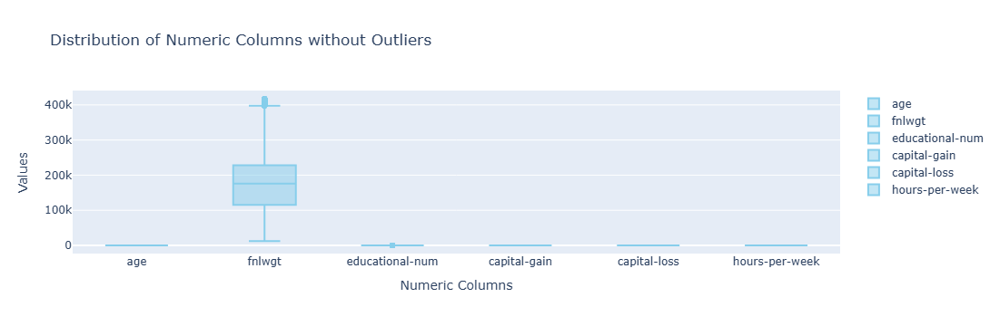

In [35]:
# Initialize a figure
fig = go.Figure()

# Iterate over numeric columns in the DataFrame
for column in df.select_dtypes(include=['number']).columns:
    fig.add_trace(go.Box(
        y=df[column],
        name=column,
        marker=dict(color='skyblue')
    ))

# Update layout with a title and axis labels
fig.update_layout(
    title='Distribution of Numeric Columns without Outliers',
    yaxis_title='Values',
    xaxis_title='Numeric Columns'
)

# Show the figure
fig.show()


# Encoding catagorical

In [36]:
catagorical_coulumns=df.select_dtypes(include=['object']).columns
catagorical_coulumns

Index(['workclass', 'education', 'marital-status', 'occupation',
       'relationship', 'race', 'gender', 'native-country', 'income'],
      dtype='object')

In [37]:
df['workclass'].value_counts()

workclass
Private             27673
Self-emp-not-inc     2990
Local-gov            2558
State-gov            1662
Self-emp-inc         1192
Federal-gov          1144
Without-pay            16
Never-worked            8
Name: count, dtype: int64

In [38]:
workclass_mapping = {
    'Private': 'Private',
    'Self-emp-not-inc': 'Self-Employed',
    'Local-gov': 'Government',
    'State-gov': 'Government',
    'Self-emp-inc': 'Self-Employed',
    'Federal-gov': 'Government',
    'Without-pay': 'Other',
    'Never-worked': 'Other'
}
df['workclass'] = df['workclass'].map(workclass_mapping)


from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
df['workclass']=le.fit_transform(df['workclass'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,11th,2.079442,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,HS-grad,2.302585,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,Assoc-acdm,2.564949,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,Some-college,2.397895,Never-married,NaN,Own-child,White,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,10th,1.945910,Never-married,Other-service,Not-in-family,White,Male,0,0,32.5,United-States,<=50K


In [39]:
#education
df['education'].value_counts()

education
HS-grad         13677
Some-college     9415
Bachelors        6334
Masters          1967
Assoc-voc        1739
11th             1614
Assoc-acdm       1354
10th             1236
9th               662
12th              593
Prof-school       506
Doctorate         395
Name: count, dtype: int64

In [40]:
education_mapping = {
    'HS-grad': 'learning',
    'Some-college': 'learning',
    'Bachelors ': 'graduate',
    'Masters': 'graduate',
    'Assoc-voc': 'Assoc',
    '11th': 'child',
    'Assoc-acdm': 'Assoc',
    '10th': 'child',
    '7th-8th': 'child',
    'Prof-school': 'graduate',
    '9th': 'child',
    '12th': 'child',
    'Doctorate':'gruduate',
    '5th-6th ': 'child',
    '1st-4th  ': 'child',
    'Preschool': 'child'
}
df['education'] = df['education'].map(education_mapping)
df['education']=le.fit_transform(df['education'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,Never-married,NaN,Own-child,White,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,Never-married,Other-service,Not-in-family,White,Male,0,0,32.5,United-States,<=50K


In [41]:
df['marital-status'].value_counts()

marital-status
Married-civ-spouse       16864
Never-married            14056
Divorced                  5637
Separated                 1274
Widowed                   1146
Married-spouse-absent      486
Married-AF-spouse           29
Name: count, dtype: int64

In [42]:
marital_status_mapping = {
    'Married-civ-spouse': 'Married',
    'Never-married': 'single',
    'Divorced': 'single',
    'Separated': 'single',
    'Widowed': 'single',
    'Married-spouse-absent': 'Married',
    'Married-AF-spouse': 'Married',
}
df['marital-status'] = df['marital-status'].map(marital_status_mapping)
df['marital-status']=le.fit_transform(df['marital-status'])
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,Machine-op-inspct,Own-child,Black,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,0,Farming-fishing,Husband,White,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,0,Protective-serv,Husband,White,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,1,NaN,Own-child,White,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,1,Other-service,Not-in-family,White,Male,0,0,32.5,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48836,3.135494,2,310152,4,2.397895,1,Protective-serv,Not-in-family,White,Male,0,0,40.0,United-States,<=50K
48837,3.332205,2,257302,0,2.564949,0,Tech-support,Wife,White,Female,0,0,38.0,United-States,<=50K
48838,3.713572,2,154374,4,2.302585,0,Machine-op-inspct,Husband,White,Male,0,0,40.0,United-States,>50K
48839,4.077537,2,151910,4,2.302585,1,Adm-clerical,Unmarried,White,Female,0,0,40.0,United-States,<=50K


In [43]:
#occupation
df['occupation'].value_counts()

occupation
Craft-repair         4954
Adm-clerical         4877
Prof-specialty       4744
Exec-managerial      4638
Sales                4521
Other-service        4172
Machine-op-inspct    2407
Transport-moving     1902
Handlers-cleaners    1707
Tech-support         1192
Farming-fishing      1109
Protective-serv       828
Priv-house-serv       171
Armed-Forces           13
Name: count, dtype: int64

In [44]:
occupation_mapping = {
    'Prof-specialty': 'Professional and Executive',
    'Craft-repair': 'Labor and Manufacturing',
    'Exec-managerial ': 'Professional and Executive',
    'Adm-clerical': 'Professional and Executive',
    'Sales': 'Sales and Services',
    'Other-service': 'Sales and Services',
    'Machine-op-inspct': 'Labor and Manufacturing',
    'Transport-moving': 'Labor and Manufacturing',
    'Handlers-cleaners': 'Labor and Manufacturing',
    'Farming-fishing ': 'Labor and Manufacturing',
    'Tech-suppor': 'Sales and Services',
    'Protective-serv': 'Sales and Services',
    'Priv-house-serv':'Sales and Services',
    'Armed-Forces ': 'Sales and Services'
}
df['occupation'] = df['occupation'].map(occupation_mapping)
df['occupation']=le.fit_transform(df['occupation'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,Own-child,Black,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,0,3,Husband,White,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,0,2,Husband,White,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,1,3,Own-child,White,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,1,2,Not-in-family,White,Male,0,0,32.5,United-States,<=50K


In [45]:
#relationship
df['relationship'].value_counts()

relationship
Husband           14814
Not-in-family     10445
Own-child          6832
Unmarried          4370
Wife               1799
Other-relative     1232
Name: count, dtype: int64

In [46]:
relationship_mapping = {
    'Husband': 'spouse',
    'Not-in-family': 'Others:',
    'Own-child': 'Immediate Family',
    'Unmarried': 'Others:',
    'Wife': 'spouse',
    'Other-relative': 'Immediate Family',
}
df['relationship'] = df['relationship'].map(relationship_mapping)
df['relationship']=le.fit_transform(df['relationship'])
df

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,0,Black,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,0,3,2,White,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,0,2,2,White,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,1,3,0,White,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,1,2,1,White,Male,0,0,32.5,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48836,3.135494,2,310152,4,2.397895,1,2,1,White,Male,0,0,40.0,United-States,<=50K
48837,3.332205,2,257302,0,2.564949,0,3,2,White,Female,0,0,38.0,United-States,<=50K
48838,3.713572,2,154374,4,2.302585,0,0,2,White,Male,0,0,40.0,United-States,>50K
48839,4.077537,2,151910,4,2.302585,1,1,1,White,Female,0,0,40.0,United-States,<=50K


In [47]:
#race
df['race'].value_counts()

race
White                 33739
Black                  3788
Asian-Pac-Islander     1250
Amer-Indian-Eskimo      407
Other                   308
Name: count, dtype: int64

In [48]:
df['race']=le.fit_transform(df['race'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,0,2,Male,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,0,3,2,4,Male,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,0,2,2,4,Male,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,1,3,0,4,Female,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,1,2,1,4,Male,0,0,32.5,United-States,<=50K


In [49]:
df['gender'].value_counts()

gender
Male      25633
Female    13859
Name: count, dtype: int64

In [50]:
#gender
df['gender']=le.fit_transform(df['gender'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,0,2,1,0,0,40.0,United-States,<=50K
1,3.663562,2,89814,4,2.302585,0,3,2,4,1,0,0,50.0,United-States,<=50K
2,3.367296,0,336951,0,2.564949,0,2,2,4,1,0,0,40.0,United-States,>50K
4,2.944439,4,103497,4,2.397895,1,3,0,4,0,0,0,32.5,United-States,<=50K
5,3.555348,2,198693,1,1.945910,1,2,1,4,1,0,0,32.5,United-States,<=50K


In [51]:
#native-country
df['native-country'].value_counts()

native-country
United-States                 35962
Mexico                          415
Philippines                     239
Germany                         168
Canada                          144
Puerto-Rico                     140
India                           123
Cuba                            104
England                         100
Jamaica                          97
South                            96
China                            94
El-Salvador                      77
Poland                           73
Japan                            73
Columbia                         72
Italy                            68
Dominican-Republic               67
Vietnam                          66
Haiti                            61
Taiwan                           54
Iran                             49
Portugal                         43
Guatemala                        43
Ecuador                          38
Nicaragua                        36
Greece                           35
Peru         

In [52]:
# Combine all categories except 'United-States'
df['native-country'] = np.where(df['native-country'] == 'United-States', 'United-States', 'other')
print(df['native-country'].value_counts())
df['native-country']=le.fit_transform(df['native-country'])
df.head()

native-country
United-States    35962
other             3530
Name: count, dtype: int64


,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,0,2,1,0,0,40.0,0,<=50K
1,3.663562,2,89814,4,2.302585,0,3,2,4,1,0,0,50.0,0,<=50K
2,3.367296,0,336951,0,2.564949,0,2,2,4,1,0,0,40.0,0,>50K
4,2.944439,4,103497,4,2.397895,1,3,0,4,0,0,0,32.5,0,<=50K
5,3.555348,2,198693,1,1.945910,1,2,1,4,1,0,0,32.5,0,<=50K


In [53]:
#income
df['income']=le.fit_transform(df['income'])
df.head()

,age,workclass,fnlwgt,education,educational-num,marital-status,occupation,relationship,race,gender,capital-gain,capital-loss,hours-per-week,native-country,income
0,3.258097,2,226802,1,2.079442,1,0,0,2,1,0,0,40.0,0,0
1,3.663562,2,89814,4,2.302585,0,3,2,4,1,0,0,50.0,0,0
2,3.367296,0,336951,0,2.564949,0,2,2,4,1,0,0,40.0,0,1
4,2.944439,4,103497,4,2.397895,1,3,0,4,0,0,0,32.5,0,0
5,3.555348,2,198693,1,1.945910,1,2,1,4,1,0,0,32.5,0,0


# Balance Data

In [54]:
x = df.drop(columns=['income'])  
y = df['income']  

In [55]:
from imblearn.over_sampling import SMOTE
resampler = SMOTE()
x,y = resampler.fit_resample(x,y)

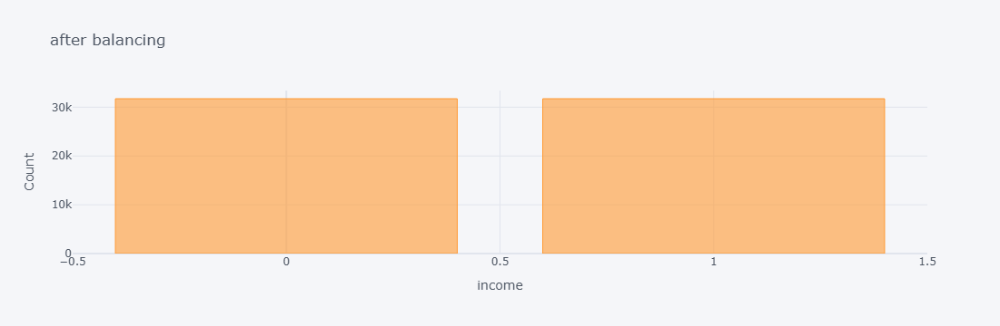

In [56]:
#income
income_counts = y.value_counts()
income_counts.iplot(kind='bar',title='after balancing',xTitle='income',yTitle='Count',theme='pearl'
)

split data

In [57]:
# Split the data into training and testing sets
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


In [58]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

model1=LogisticRegression()
model2=DecisionTreeClassifier()
model3=RandomForestClassifier()

In [59]:
def evaluate_model(y_test, y_pred):
    print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
    print(f"Precision: {precision_score(y_test, y_pred)}")
    print(f"Recall: {recall_score(y_test, y_pred)}")
    cm = confusion_matrix(y_test, y_pred)
    sensitivity = cm[1, 1] / (cm[1, 1] + cm[1, 0])
    specificity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
    print(f"Sensitivity: {sensitivity}")
    print(f"Specificity: {specificity}")
    print(f"ROC AUC: {roc_auc_score(y_test, y_pred)}")
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
    plt.show()

models befor scaling and normalization and dimainolity reduction

In [60]:
#from sklearn.metrics import accuracy_score, precision_score, recall_score,roc_auc_score,classification_report, confusion_matrix # Importing confusion_matrix
def pred (model):
  model.fit(x_train,y_train)
  y_pred=model.predict(x_test)
  accuracyy = accuracy_score(y_test, y_pred)
  return accuracyy

In [61]:
#Evaluate the model
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score

from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt

In [62]:
print('Logistic Regression: ',pred(model1))
final.append(pred(model1))

C:\Users\Amera\Documents\anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Logistic Regression:  0.7418491100960781


C:\Users\Amera\Documents\anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [63]:
print('Decision Tree: ',pred(model2))
final.append(pred(model2))

Decision Tree:  0.8598991967238935


In [64]:
print('Random Forest: ',pred(model3))
final.append(pred(model3))

Random Forest:  0.8914002205071665


models after scaling

In [65]:
from sklearn.preprocessing import StandardScaler,MinMaxScaler
# Apply scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(x_train)
X_test_scaled = scaler.transform(x_test)

In [66]:
def pred1 (model):
  model.fit(X_train_scaled,y_train)
  y_pred_scaled=model.predict(X_test_scaled)
  accuracy_scaled = accuracy_score(y_test, y_pred_scaled)
  return accuracy_scaled

In [67]:
print('Logistic Regression: ',pred1(model1))
final.append(pred1(model1))

Logistic Regression:  0.8502913844699953


In [68]:
print('Decision Tree: ',pred1(model2))
final.append(pred1(model2))

Decision Tree:  0.8594266813671444


In [69]:
print('Random Forest: ',pred1(model3))
final.append(pred1(model3))

Random Forest:  0.8914789730666247


model after normalization

In [70]:
normalizer = MinMaxScaler()
X_train_normalized = normalizer.fit_transform(x_train)
X_test_normalized = normalizer.transform(x_test)

In [71]:
def pred2 (model):
  model.fit(X_train_normalized,y_train)
  y_pred_normalized=model.predict(X_test_normalized)
  accuracy_normalized = accuracy_score(y_test, y_pred_normalized)
  return accuracy_normalized

In [72]:
print('Logistic Regression: ',pred2(model1))
final.append(pred2(model1))

Logistic Regression:  0.8508426523862026


In [73]:
print('Decision Tree: ',pred2(model2))
final.append(pred2(model2))

Decision Tree:  0.8593479288076863


In [74]:
print('Random Forest: ',pred2(model3))
final.append(pred2(model3))

Random Forest:  0.8908489525909592


Dimanianilty Reduction

In [75]:
coulumns=df.columns
coulumns=list(coulumns)
coulumns.pop()

'income'

In [76]:
X_train_reduction = pd.DataFrame(x_train,columns=coulumns)
X_test_reduction = pd.DataFrame(x_test,columns=coulumns)

y_train_reduction = pd.Series(y_train, name="income")

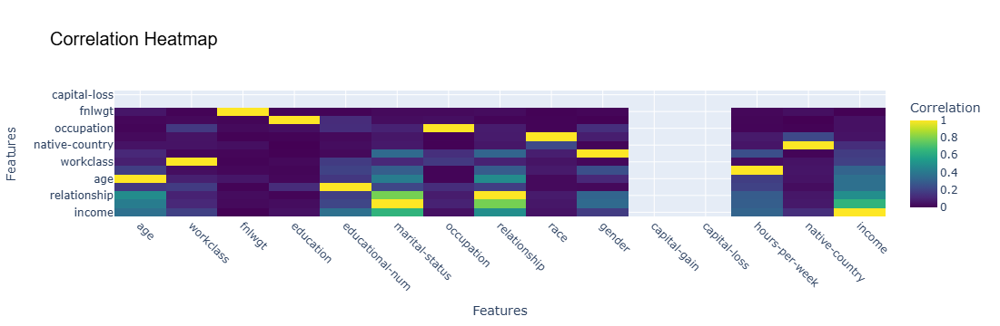

In [77]:
combined = pd.concat([X_train_reduction, y_train], axis=1)

correlation_matrix = combined.corr().abs()  # Absolute correlation values
correlation_sorted = correlation_matrix.sort_values("income", ascending=False)

# Create the heatmap using Plotly
fig = go.Figure(data=go.Heatmap(
    z=correlation_sorted.values,  # Correlation matrix values
    x=correlation_sorted.columns,  # Column names (features)
    y=correlation_sorted.index,    # Row names (features)
    colorscale='Viridis',          # Color scale
    colorbar=dict(title="Correlation"),  # Colorbar title
))

# Update layout to add title and axis labels
fig.update_layout(
    title="Correlation Heatmap",
    xaxis_title="Features",
    yaxis_title="Features",
    title_font=dict(size=20, family="Arial", color="black"),
    xaxis=dict(tickangle=45),  # Rotate x-axis labels for better visibility
)

fig.show()


In [78]:
X_train_reduction.drop(['capital-gain','capital-loss','fnlwgt','native-country','education','workclass','occupation','race','gender'],axis=1,inplace=True)
X_test_reduction.drop(['capital-gain','capital-loss','fnlwgt','native-country','education','workclass','occupation','race','gender'],axis=1,inplace=True)

models after dimanianlity reduction

In [79]:
def pred3 (model):
  model.fit(X_train_reduction,y_train)
  y_pred_reduction=model.predict(X_test_reduction)
  accuracy_reduction = accuracy_score(y_test, y_pred_reduction)
  return accuracy_reduction

In [80]:
print('Logistic Regression: ',pred3(model1))
final.append(pred3(model1))

Logistic Regression:  0.8421011182863443


In [81]:
print('Decision Tree: ',pred3(model2))
final.append(pred3(model2))

Decision Tree:  0.8824224287289337


In [82]:
print('Random Forest: ',pred2(model3))
final.append(pred3(model3))

Random Forest:  0.8921877461017483


# The Final Result for models

In [83]:
X_train_scaled = pd.DataFrame(X_train_scaled,columns=coulumns)
X_test_scaled = pd.DataFrame(X_test_scaled,columns=coulumns)

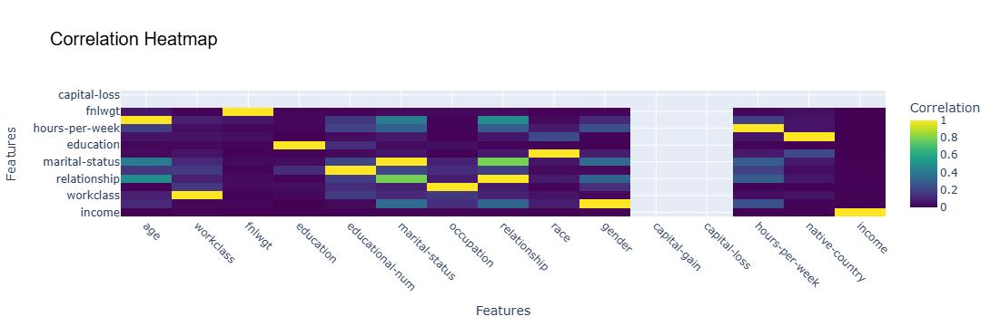

In [84]:
combined = pd.concat([X_train_scaled, y_train], axis=1)

correlation_matrix = combined.corr().abs()  # Absolute correlation values
correlation_sorted = correlation_matrix.sort_values("income", ascending=False)

# Create the heatmap using Plotly
fig = go.Figure(data=go.Heatmap(
    z=correlation_sorted.values,  # Correlation matrix values
    x=correlation_sorted.columns,  # Column names (features)
    y=correlation_sorted.index,    # Row names (features)
    colorscale='Viridis',          # Color scale
    colorbar=dict(title="Correlation"),  # Colorbar title
))

# Update layout to add title and axis labels
fig.update_layout(
    title="Correlation Heatmap",
    xaxis_title="Features",
    yaxis_title="Features",
    title_font=dict(size=20, family="Arial", color="black"),
    xaxis=dict(tickangle=45),  # Rotate x-axis labels for better visibility
)

fig.show()


In [85]:
X_train_scaled.drop(['capital-gain','capital-loss','fnlwgt','native-country','education','workclass','occupation','race','gender'],axis=1,inplace=True)
X_test_scaled.drop(['capital-gain','capital-loss','fnlwgt','native-country','education','workclass','occupation','race','gender'],axis=1,inplace=True)

In [86]:
X_train_scaled.head()

,age,educational-num,marital-status,relationship,hours-per-week
0,0.332557,0.685643,-0.744142,0.827509,-0.360051
1,-0.611654,-0.550387,-0.744142,0.827509,1.557317
2,-0.838789,0.235095,1.343830,-1.982603,-1.209770
3,0.837991,1.044764,-0.744142,0.827509,0.338269
4,0.164569,0.760086,-0.744142,-0.577547,1.286828


# LogisticRegression

In [87]:
from sklearn.linear_model import LogisticRegression
LR= LogisticRegression()

# Train the model
LR.fit(X_train_scaled, y_train)

# Make predictions
y_pred_LR = LR.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred_LR)
final.append(accuracy)

Accuracy: 0.8419436131674279
Precision: 0.8063531696490498
Recall: 0.9048879202988792
Sensitivity: 0.9048879202988792
Specificity: 0.7774944214217405
ROC AUC: 0.8411911708603099


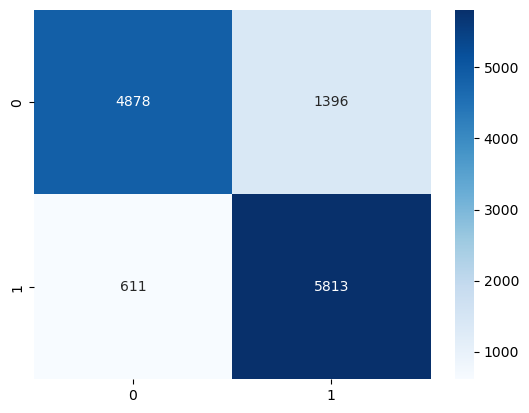

In [88]:
#Evaluate the model
evaluate_model(y_test,y_pred_LR)


# DecisionTreeClassifier

In [89]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(random_state=42)

# Train the model
dt.fit(X_train_scaled, y_train)

# Make predictions
y_pred_dt = dt.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred_dt)
final.append(accuracy)

Accuracy: 0.8828161915262246
Precision: 0.9175972927241963
Recall: 0.8441780821917808
Sensitivity: 0.8441780821917808
Specificity: 0.9223780682180427
ROC AUC: 0.8832780752049118


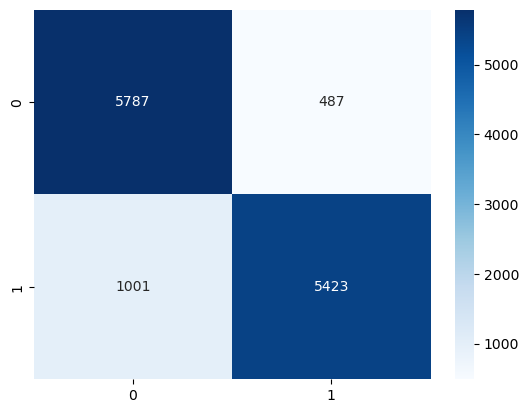

In [90]:
#Evaluate the model
evaluate_model(y_test,y_pred_dt)

# RandomForestClassifier

In [91]:
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model
RF.fit(X_train_scaled, y_train)

# Make predictions
y_pred_rf = RF.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred_rf)
final.append(accuracy)


Accuracy: 0.8840762324775555
Precision: 0.9096624751819987
Recall: 0.8558530510585305
Sensitivity: 0.8558530510585305
Specificity: 0.9129741791520561
ROC AUC: 0.8844136151052934


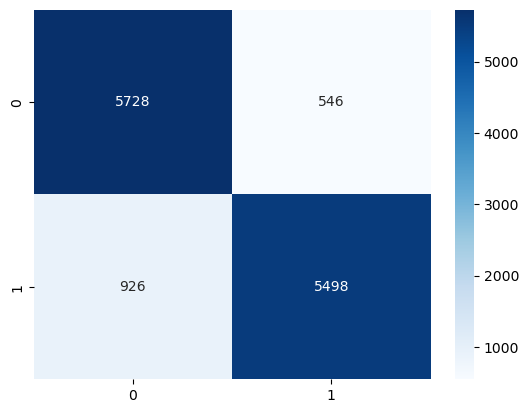

In [92]:
#Evaluate the model
evaluate_model(y_test,y_pred_rf)

pca

In [93]:
from sklearn.decomposition import PCA # Importing the PCA class

pca = PCA(n_components=4)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)


In [94]:
def pred4(model):
  model.fit(X_train_pca, y_train) 
  y_pred_pca = model.predict(X_test_pca)
  accuracy_pca = accuracy_score(y_test, y_pred_pca) 
  return accuracy_pca 

In [95]:
final.append(pred4(model1))
pred4(model1)

0.8241455347298787

In [96]:
final.append(pred4(model2))
pred4(model2)

0.8559615687509844

In [97]:
final.append(pred4(model3))
pred4(model3)

0.8747046779020318

In [98]:
final=np.array(final)
result=final.reshape(6,3)
index=['Befor scaling,normalize,dimaniality','after scaling','after normalization','after Reduction','conctante them','pca']
columns=['Logistic Regression','Decision Tree','Random Forest']
final_result=pd.DataFrame(result,index=index,columns=columns)

In [99]:
final_result

,Logistic Regression,Decision Tree,Random Forest
"Befor scaling,normalize,dimaniality",0.741849,0.858797,0.891479
after scaling,0.850291,0.860765,0.892109
after normalization,0.850843,0.860372,0.891085
after Reduction,0.842101,0.882659,0.882974
conctante them,0.841944,0.882816,0.884076
pca,0.824146,0.855489,0.874390


accuracy incease after scaling and reduction

# Trials

**1. Logistic with different Parameters**

In [160]:
# Define different hyperparameters of Logistic regression
logistic_regression_hyperparameters  = [
    {'C': 0.1, 'solver': 'liblinear', 'max_iter': 100},
    {'C': 1.0, 'solver': 'lbfgs', 'max_iter': 200},
    {'C': 10.0, 'solver': 'saga', 'max_iter': 300},
    {'C': 1.0, 'solver': 'newton-cg', 'max_iter': 100}
]

In [161]:
best_results = {}

In [162]:
final_accuracies = []
best_lr_accuracy = 0
best_lr_params = None
for params in logistic_regression_hyperparameters:
    LR = LogisticRegression(**params, random_state=42)
    LR.fit(X_train_scaled, y_train)
    y_pred_LR = LR.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred_LR)
    if accuracy > best_lr_accuracy:
        best_lr_accuracy = accuracy
        best_lr_params = params
    final_accuracies.append((params, accuracy))

In [163]:
best_results['Logistic Regression'] = {
    'best_params': best_lr_params,
    'accuracy': best_lr_accuracy
}

In [164]:
for params, accuracy in final_accuracies:
    print(f"Logistic regression Hyperparameters: {params} - Accuracy: {accuracy}")

Logistic regression Hyperparameters: {'C': 0.1, 'solver': 'liblinear', 'max_iter': 100} - Accuracy: 0.8423373759647188
Logistic regression Hyperparameters: {'C': 1.0, 'solver': 'lbfgs', 'max_iter': 200} - Accuracy: 0.8419436131674279
Logistic regression Hyperparameters: {'C': 10.0, 'solver': 'saga', 'max_iter': 300} - Accuracy: 0.8419436131674279
Logistic regression Hyperparameters: {'C': 1.0, 'solver': 'newton-cg', 'max_iter': 100} - Accuracy: 0.8419436131674279


**2. Decision Tree with different Hyperparameters**

In [165]:
# Define different hyperparameters of Decision tree
decision_tree_hyperparameters  = [
    {'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'gini'},
    {'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 4, 'criterion': 'entropy'},
    {'max_depth': 7, 'min_samples_split': 5, 'min_samples_leaf': 2, 'criterion': 'gini'},
    {'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'entropy'}
]

In [166]:
final_accuracies = []
best_dt_accuracy = 0
best_dt_params = None
for params in decision_tree_hyperparameters:
    dt = DecisionTreeClassifier(random_state=42, **params)
    dt.fit(X_train_scaled, y_train)
    y_pred_dt = dt.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred_dt)
    if accuracy > best_dt_accuracy:
        best_dt_accuracy = accuracy
        best_dt_params = params
    final_accuracies.append((params, accuracy))

In [167]:
best_results['Decision Tree'] = {
    'best_params': best_dt_params,
    'accuracy': best_dt_accuracy
}

In [168]:
for params, accuracy in final_accuracies:
    print(f"Decision tree Hyperparameters: {params} - Accuracy: {accuracy}")

Decision tree Hyperparameters: {'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'gini'} - Accuracy: 0.8627342888643881
Decision tree Hyperparameters: {'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 4, 'criterion': 'entropy'} - Accuracy: 0.88604504646401
Decision tree Hyperparameters: {'max_depth': 7, 'min_samples_split': 5, 'min_samples_leaf': 2, 'criterion': 'gini'} - Accuracy: 0.8733658843912427
Decision tree Hyperparameters: {'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'entropy'} - Accuracy: 0.8834462120018901


**3. Random Forest with different Hyperparameters**

In [169]:
# Define different hyperparameters of Random Forest
random_forest_hyperparameters  = [
    {'n_estimators': 100, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'gini'},
    {'n_estimators': 150, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 3, 'criterion': 'entropy'},
    {'n_estimators': 200, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 4, 'criterion': 'gini'},
    {'n_estimators': 50, 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 2, 'criterion': 'entropy'}
]

In [170]:
final_accuracies = []
best_rf_accuracy = 0
best_rf_params = None
for params in random_forest_hyperparameters:
    RF = RandomForestClassifier(random_state=42, **params)
    RF.fit(X_train_scaled, y_train)
    y_pred_rf = RF.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred_rf)
    if accuracy > best_rf_accuracy:
        best_rf_accuracy = accuracy
        best_rf_params = params
    final_accuracies.append((params, accuracy))

In [172]:
best_results['Random Forest'] = {
    'best_params': best_rf_params,
    'accuracy': best_rf_accuracy
}

In [173]:
for params, accuracy in final_accuracies:
    print(f"Hyperparameters: {params} - Accuracy: {accuracy}")

Hyperparameters: {'n_estimators': 100, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1, 'criterion': 'gini'} - Accuracy: 0.88171365569381
Hyperparameters: {'n_estimators': 150, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 3, 'criterion': 'entropy'} - Accuracy: 0.8895889116396283
Hyperparameters: {'n_estimators': 200, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 4, 'criterion': 'gini'} - Accuracy: 0.8879351078910065
Hyperparameters: {'n_estimators': 50, 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 2, 'criterion': 'entropy'} - Accuracy: 0.8891951488423374


In [174]:
df_best_results = pd.DataFrame.from_dict(best_results, orient='index')
df_best_results.head()

,best_params,accuracy
Logistic Regression,"{'C': 0.1, 'solver': 'liblinear', 'max_iter': ...",0.842337
Decision Tree,"{'max_depth': 10, 'min_samples_split': 10, 'mi...",0.886045
Random Forest,"{'n_estimators': 150, 'max_depth': 20, 'min_sa...",0.889589
